In [1]:
import sqlite3
import pandas as pd
db_name='yelp_database.db'
conn = sqlite3.connect(db_name)

In [2]:
print("\nRestraunt Table:")
restaurant_df = pd.read_sql("""SELECT * FROM Restaurants""", con = conn)
restaurant_df


Restraunt Table:


,restaurant_id,name,stars,num_reviews,price_range,category_list
0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"
1,1,Oasis Vegan Veggie Parlor,4.5,97,$,"Vegan, Vegetarian"
2,2,50Kitchen,4.5,58,NA,Asian Fusion
3,3,Home.Stead Bakery & Cafe,4.5,118,$,"Coffee & Tea, Sandwiches, Bakeries"
4,4,Honeycomb Cafe,4.5,68,$,"Coffee & Tea, Breakfast & Brunch, Sandwiches"
...,...,...,...,...,...,...
183,183,Hop Sing’s,No rating,0,NA,Restaurants
184,184,Nice N’ Clean Jamaican Cuisine,No rating,0,NA,Caribbean
185,185,Foley Fish Company,No rating,0,NA,Seafood
186,186,Cibao Restaurant,No rating,0,NA,Pizza


In [3]:
df = pd.read_sql("""
          SELECT * FROM 
          ((Reviews 
          left join Restaurants on Reviews.restaurant_id = Restaurants.restaurant_id) 
          )
            """, con = conn)
df.head()

,review_id,review_date,review_rating,review_text,photos,user_id,restaurant_id,restaurant_id,name,stars,num_reviews,price_range,category_list
0,0,11/15/2020,5 star rating,Great food and awesome atmosphere. Service was...,0,1,0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"
1,1,1/13/2020,3 star rating,Came in here the other day to grab coffee and ...,0,2,0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"
2,2,9/5/2020,3 star rating,The great reviews for my expectations too high...,0,3,0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"
3,3,12/1/2019,5 star rating,Wow this place is special. Recently coming bac...,0,4,0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"
4,4,11/3/2019,5 star rating,This cute cafe is a 5 minute walk from the red...,0,5,0,0,Zia Gianna,4.5,70,$$,"Coffee & Tea, Italian, Bakeries"


In [4]:
df1 = df[['stars','review_text']]
df1.head()

,stars,review_text
0,4.5,Great food and awesome atmosphere. Service was...
1,4.5,Came in here the other day to grab coffee and ...
2,4.5,The great reviews for my expectations too high...
3,4.5,Wow this place is special. Recently coming bac...
4,4.5,This cute cafe is a 5 minute walk from the red...


In [5]:
# df.groupby('category_list')
# df.head()

df2 = (df1.groupby('stars')['review_text'].apply(',\n'.join).reset_index())
print(df2)


  stars                                        review_text
0     1  Since the local Papa John's closed, I was left...
1   1.5  NEVER thought I would give one of my favorite ...
2     2  I'm going to start off by saying that my fianc...
3   2.5  This is the best Applebees I have ever been to...
4     3  I love this place. Authentic food. Great servi...
5   3.5  We had a wonderful take-out feast last night t...
6     4  Finally I was able to visit Banh Mi Ba Le...an...
7   4.5  Great food and awesome atmosphere. Service was...
8     5  I live in the North Shore area and let's say w...


In [ ]:
pd.DataFrame(df2).to_csv('/Users/16175/Desktop/tazaa_tazaa.csv',index=False)

In [179]:
import gensim
finaldoc_list = df2['review_text'].values.tolist()
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))  # deacc=True removes punctuations
data_words = list(sent_to_words(finaldoc_list))
print(len(data_words))
print((data_words))

9
[['since', 'the', 'local', 'papa', 'john', 'closed', 'was', 'left', 'to', 'order', 'from', 'domino', 'since', 'wanted', 'thin', 'crust', 'ordered', 'meatzza', 'pizza', 'which', 'is', 'their', 'meat', 'lovers', 'and', 'added', 'onions', 'to', 'it', 'when', 'it', 'arrived', 'it', 'didn', 'have', 'any', 'meat', 'on', 'it', 'just', 'onions', 'also', 'the', 'other', 'items', 'ordered', 'with', 'the', 'pizza', 'chocolate', 'cakes', 'and', 'chicken', 'nugget', 'things', 'were', 'missing', 'the', 'sauces', 'called', 'the', 'store', 'and', 'after', 'several', 'minutes', 'they', 'answered', 'the', 'phone', 'explained', 'the', 'problem', 'and', 'even', 'though', 'manager', 'clearly', 'didn', 'believe', 'me', 'he', 'said', 'he', 'have', 'the', 'correct', 'pizza', 'out', 'to', 'me', 'right', 'away', 'the', 'original', 'order', 'took', 'approximately', 'mins', 'to', 'get', 'to', 'me', 'this', 'replacement', 'pizza', 'he', 'was', 'getting', 'to', 'me', 'immediately', 'took', 'an', 'hour', 'highly',

In [180]:
#Conerting to lower case
texts = [[x.casefold() for x in sublst] for sublst in data_words]
#print(texts)

In [181]:
#defining function to convert word contractions 
def decontracted(phrase_list):
    map_list = {"t":"not", "re":"are", "s":"is","d":"would", "ll":"will", "ve":"have", "m":"am","gonna":"going","gotta":"got"}
    final_list = []
    for phrases in phrase_list:
        int_list = []
        for phrase in phrases:
            if phrase in map_list:
                orig = map_list[phrase]
            else:
                orig = phrase
            int_list.append(orig)
        final_list.append(int_list)
    return final_list

list_texts = decontracted(texts)
print(len(list_texts))

9


In [182]:
import re
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from pprint import pprint
import spacy
import nltk 
from nltk.corpus import stopwords
import logging
import string

In [265]:
import nltk
from nltk.corpus import wordnet as wn
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import LancasterStemmer
from nltk.stem import WordNetLemmatizer
from nltk import word_tokenize, pos_tag
from collections import defaultdict
stop_words = stopwords.words('english')
nlp = spacy.load("en_core_web_sm")
nlp.max_length = 1726480


new_words = ['really','also','well','go','get','come','see','side','lot','able','door','try','would','always','take','patio','ask','actual',
            'definitely','say','little','give','small','find','even','thing','people','first','pretty','think','could','normally','third'
            'still','ever','way','bit','day','tell','sure','many','last','may','seem','usually','however','probably','guess',
            'put','maybe','end','actually','else','absolutely','let','almost','instead','back','fyi','approximately',
             'still','guy','way','several','thing','food','literally','ago','tell','pm','ok','bf','ca','co','dj','ny','th','ox','gp','tl','jp','duck',
            'enough','sleep','tho','amc','name','nee','much','many','several','exact','regardless','anyway','feel','word','basically','later','thank',
             'set','make','become','comment','hard','order','scallop','sum','taco','calamari','downstairs','msg','restaurant','overall','today',
            'review']
stop_words.extend(new_words)

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    for sent in texts:
#         nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
        doc = nlp(" ".join(sent))
    
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out

def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

# Remove Stop Words
data_words_nostops = remove_stopwords(list_texts)
# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words_nostops, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])

final_doc = remove_stopwords(data_lemmatized)
print(final_doc)

[['local', 'papa', 'close', 'leave', 'want', 'thin', 'crust', 'lover', 'add', 'onion', 'arrive', 'meat', 'onion', 'item', 'pizza', 'chocolate', 'cake', 'chicken', 'nugget', 'miss', 'sauce', 'call', 'store', 'minute', 'answer', 'phone', 'explain', 'problem', 'manager', 'clearly', 'believe', 'correct', 'pizza', 'right', 'away', 'original', 'min', 'replacement', 'pizza', 'immediately', 'hour', 'highly', 'recommend', 'avoid', 'domino', 'must', 'due', 'convenience', 'pick', 'check', 'leave', 'store', 'star', 'option', 'soooo', 'frustrated', 'place', 'week', 'never', 'place', 'keep', 'call', 'talk', 'hold', 'work', 'odd', 'hour', 'place', 'talk', 'wish', 'read', 'corporate', 'involved', 'place', 'bunch', 'start', 'shut', 'steal', 'money', 'pizza', 'hour', 'half', 'forever', 'deliver', 'assumed', 'call', 'expect', 'delivery', 'top', 'provide', 'deform', 'cold', 'pizza', 'pizza', 'place', 'delivery', 'driver', 'hire', 'carry', 'call', 'cause', 'fulfil', 'yet', 'busy', 'short', 'driver', 'provi

In [266]:
flatten_list = []
for sublist in final_doc:
    for item in sublist:
        flatten_list.append(item)
pd.set_option('display.max_rows', 6000)       
df = pd.DataFrame(flatten_list, columns = ['Words'])
df['Count'] = '1'
group_name = pd.pivot_table(df, index = ['Words'],values =['Count'], aggfunc='count')
refined_list2 = (group_name.sort_values(by='Count', ascending=False)).reset_index()
#pd.DataFrame(refined_list2).to_csv('/Users/16175/Desktop/tazaa_tazaa.csv',index=False)
print(refined_list2)

              Words  Count
0              good   8300
1             place   7358
2             great   5077
3              time   4932
4           service   4142
...             ...    ...
12823      isabella      1
12824     irritable      1
12825  irresistible      1
12826   irregularly      1
12827         zuppa      1

[12828 rows x 2 columns]


In [267]:
res = [[ele for ele in sub if ele not in stop_words] for sub in final_doc] 
print(res)

[['local', 'papa', 'close', 'leave', 'want', 'thin', 'crust', 'lover', 'add', 'onion', 'arrive', 'meat', 'onion', 'item', 'pizza', 'chocolate', 'cake', 'chicken', 'nugget', 'miss', 'sauce', 'call', 'store', 'minute', 'answer', 'phone', 'explain', 'problem', 'manager', 'clearly', 'believe', 'correct', 'pizza', 'right', 'away', 'original', 'min', 'replacement', 'pizza', 'immediately', 'hour', 'highly', 'recommend', 'avoid', 'domino', 'must', 'due', 'convenience', 'pick', 'check', 'leave', 'store', 'star', 'option', 'soooo', 'frustrated', 'place', 'week', 'never', 'place', 'keep', 'call', 'talk', 'hold', 'work', 'odd', 'hour', 'place', 'talk', 'wish', 'read', 'corporate', 'involved', 'place', 'bunch', 'start', 'shut', 'steal', 'money', 'pizza', 'hour', 'half', 'forever', 'deliver', 'assumed', 'call', 'expect', 'delivery', 'top', 'provide', 'deform', 'cold', 'pizza', 'pizza', 'place', 'delivery', 'driver', 'hire', 'carry', 'call', 'cause', 'fulfil', 'yet', 'busy', 'short', 'driver', 'provi

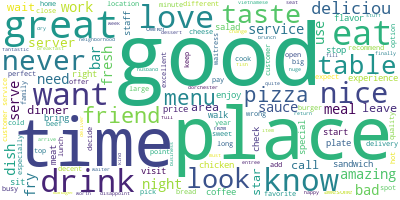

In [268]:
from wordcloud import WordCloud 
sample_list = []
for sublist in res:
    for item in sublist:
        sample_list.append(item)
        
list_string = ','.join((sample_list))
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=5, contour_color='steelblue')
wordcloud.generate(list_string)
wordcloud.to_image()

In [269]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=5, threshold=50) # higher threshold fewer phrases.

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

bigrams = make_bigrams(final_doc)


print(bigrams)

[['local', 'papa', 'close', 'leave', 'want', 'thin_crust', 'lover', 'add', 'onion', 'arrive', 'meat', 'onion', 'item', 'pizza', 'chocolate_cake', 'chicken', 'nugget', 'miss', 'sauce', 'call', 'store', 'minute', 'answer', 'phone', 'explain', 'problem', 'manager', 'clearly', 'believe', 'correct', 'pizza', 'right', 'away', 'original', 'min', 'replacement', 'pizza', 'immediately', 'hour', 'highly_recommend', 'avoid', 'domino', 'must', 'due', 'convenience', 'pick', 'check', 'leave', 'store', 'star', 'option', 'soooo', 'frustrated', 'place', 'week', 'never', 'place', 'keep', 'call', 'talk', 'hold', 'work', 'odd', 'hour', 'place', 'talk', 'wish', 'read', 'corporate', 'involved', 'place', 'bunch', 'start', 'shut', 'steal', 'money', 'pizza', 'hour', 'half', 'forever', 'deliver', 'assumed', 'call', 'expect', 'delivery', 'top', 'provide', 'deform', 'cold', 'pizza', 'pizza', 'place', 'delivery_driver', 'hire', 'carry', 'call', 'cause', 'fulfil', 'yet', 'busy', 'short', 'driver', 'provide', 'notice

In [270]:
id2word = corpora.Dictionary(bigrams)
id2word.filter_extremes(no_below=2) 
texts = bigrams
corpus = [id2word.doc2bow(text) for text in texts]

In [271]:
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=2, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics='TRUE')

In [272]:
#dominant words of each topic
print("First Unigram model results: \n")
print(lda_model.print_topics())
doc_lda = lda_model[corpus]

First Unigram model results: 

[(0, '0.028*"olive_garden" + 0.013*"applebee" + 0.011*"papa" + 0.010*"panera" + 0.003*"chipotle" + 0.003*"upham" + 0.003*"subway" + 0.003*"unlimited" + 0.002*"lasagna" + 0.002*"straw"'), (1, '0.006*"raman" + 0.006*"roti" + 0.005*"indian" + 0.005*"gem" + 0.004*"course_beef" + 0.004*"irish" + 0.003*"tavolo" + 0.003*"bakery" + 0.003*"mussel" + 0.003*"dbar"')]


In [273]:
# Compute Perplexity
from gensim.models import CoherenceModel
print("First Unigram model results: \n")
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=bigrams, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)

First Unigram model results: 


Perplexity:  -8.045782393266771

Coherence Score:  0.5364421578244569


In [274]:
#Visualizing Topics
import pyLDAvis.gensim
import gensim
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)
vis

PreparedData(topic_coordinates=              x    y  topics  cluster       Freq
topic                                           
1      0.079674  0.0       1        1  91.821472
0     -0.079674  0.0       2        1   8.178522, topic_info=                Term        Freq       Total Category  logprob  loglift
831     olive_garden   94.000000   94.000000  Default  30.0000  30.0000
88              papa   46.000000   46.000000  Default  29.0000  29.0000
205         applebee   42.000000   42.000000  Default  28.0000  28.0000
854           panera   31.000000   31.000000  Default  27.0000  27.0000
1109           straw   31.000000   31.000000  Default  26.0000  26.0000
323         chipotle   17.000000   17.000000  Default  25.0000  25.0000
721          lasagna   22.000000   22.000000  Default  24.0000  24.0000
1116          subway   18.000000   18.000000  Default  23.0000  23.0000
742             loaf   22.000000   22.000000  Default  22.0000  22.0000
1038           shout   38.000000   38.000000  Default  21.0000  21.0000
232           basket   35.000000   35.000000  Default  20.0000  20.0000
1777       wing_ding   24.000000   24.000000  Default  19.0000  19.0000
1225           upham   13.000000   13.000000  Default  18.0000  18.0000
1216       unlimited   14.000000   14.000000  Default  17.0000  17.0000
1727             tap   56.000000   56.000000  Default  16.0000  16.0000
230             bank   28.000000   28.000000  Default  15.0000  15.0000
455    disrespectful   18.000000   18.000000  Default  14.0000  14.0000
328            chunk   67.000000   67.000000  Default  13.0000  13.0000
1184            tour   22.000000   22.000000  Default  12.0000  12.0000
900           poster   15.000000   15.000000  Default  11.0000  11.0000
151         ignorant   15.000000   15.000000  Default  10.0000  10.0000
726            layer   34.000000   34.000000  Default   9.0000   9.0000
771             mint   30.000000   30.000000  Default   8.0000   8.0000
1320         biscuit   41.000000   41.000000  Default   7.0000   7.0000
870             peak   25.000000   25.000000  Default   6.0000   6.0000
866        patronize   15.000000   15.000000  Default   5.0000   5.0000
349       commercial   11.000000   11.000000  Default   4.0000   4.0000
459         distract   20.000000   20.000000  Default   3.0000   3.0000
416            delay   20.000000   20.000000  Default   2.0000   2.0000
682         informed   17.000000   17.000000  Default   1.0000   1.0000
2278           irish  126.428696  127.027725   Topic1  -5.6336   0.0806
4289          tavolo  108.597954  109.134308   Topic1  -5.7857   0.0804
2434          oyster  100.135475  100.652039   Topic1  -5.8668   0.0802
4072            roti  196.442459  197.509033   Topic1  -5.1930   0.0799
2662           sport   86.049423   86.521950   Topic1  -6.0184   0.0798
2186             gem  160.843765  161.748016   Topic1  -5.3929   0.0797
1896             bun   77.599663   78.044792   Topic1  -6.1218   0.0796
2357         mexican   90.654816   91.195633   Topic1  -5.9663   0.0794
4359         truffle   84.097481   84.608147   Topic1  -6.0413   0.0793
2500             pub   77.554504   78.026405   Topic1  -6.1223   0.0793
1892          buffet   79.419151   79.905052   Topic1  -6.0986   0.0792
2360            milk   66.326271   66.738892   Topic1  -6.2787   0.0791
2024            dbar  102.760887  103.400383   Topic1  -5.8409   0.0791
4270      sweet_life   68.192543   68.618126   Topic1  -6.2510   0.0791
3197     course_beef  139.190384  140.059784   Topic1  -5.5375   0.0791
2448             pat   69.124107   69.557076   Topic1  -6.2374   0.0791
939            raman  197.051102  198.317520   Topic1  -5.1899   0.0789
3599          indian  178.303894  179.491379   Topic1  -5.2898   0.0787
1859  beer_selection   63.474113   63.898811   Topic1  -6.3227   0.0787
2689  street_parking   77.471207   77.992744   Topic1  -6.1234   0.0786
3808          omelet   65.327347   65.772621   Topic1  -6.2939   0.0785
2817         vine

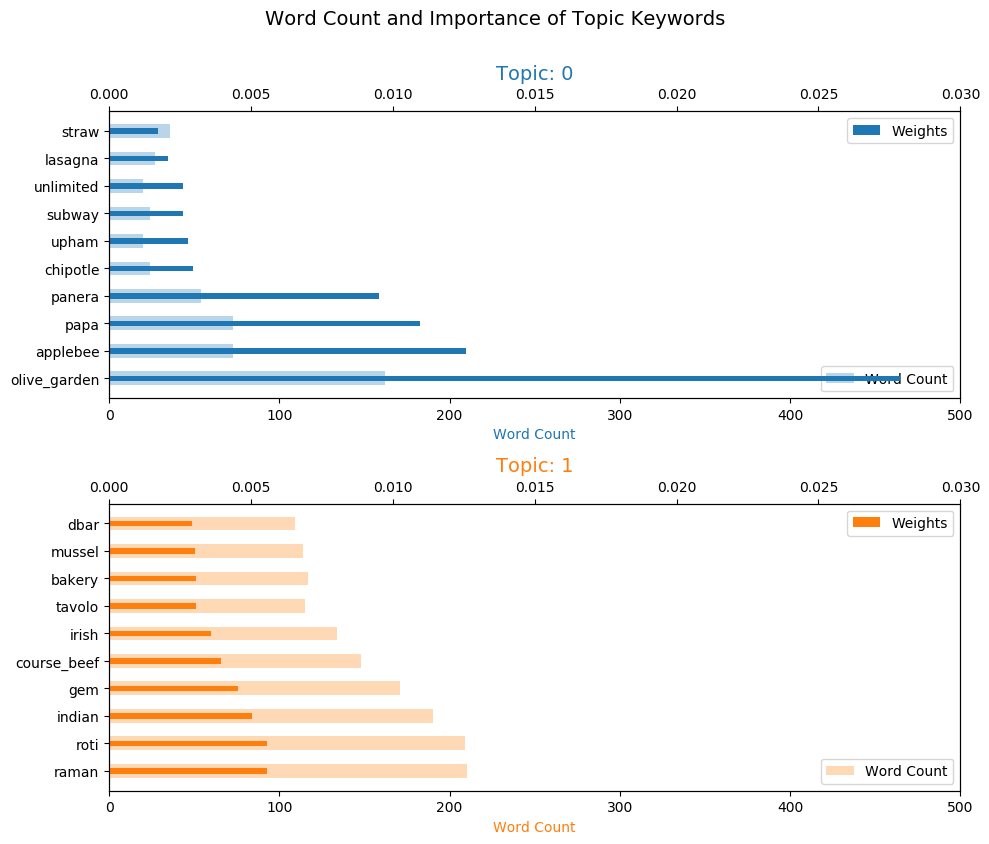

In [278]:
#plotting horizontal bar charts to show word count and importance for each topic

import matplotlib.pyplot as plot
import matplotlib.colors as mcolors
from collections import Counter
topics = lda_model.show_topics(formatted=False)
data_flat = [w for w_list in bigrams for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count']) 

#Plot Word Count and Weights of Topic Keywords
fig, axes = plot.subplots(2,1,figsize=(10,8), dpi=100)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    #data = df.loc[df.topic_id==i,:]
    #y = data['word']
    ax.barh(y='word', width= 'word_count',data = df.loc[df.topic_id==i,:], color=cols[i], height=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twiny()
    ax_twin.barh(y='word', width= 'importance',data = df.loc[df.topic_id==i,:],color=cols[i], height=0.2, label='Weights')
    ax.set_xlabel('Word Count', color=cols[i])
    ax_twin.set_xlim(0, 0.030); ax.set_xlim(0, 500)
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=14)
    ax.tick_params(axis='x', left=False)
    #ax.set_yticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='lower right'); ax_twin.legend(loc='upper right')
#     ax.legend(bbox_to_anchor=(0.5, 1.0))
#     ax_twin.legend(bbox_to_anchor=(0.25, 1.0))
    

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=14, y=1.05)    
plot.show()

In [177]:
def format_topics_sentences(ldamodel=None, corpus=corpus, texts=res):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row_list in enumerate(lda_model[corpus]):
        row = row_list[0] if lda_model.per_word_topics else row_list            
        # print(row)
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = lda_model.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return(sent_topics_df)


df_topic_sents_keywords = format_topics_sentences(ldamodel=lda_model, corpus=corpus, texts=res)

# Format
df_dominant_topic = df_topic_sents_keywords.reset_index()
df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']
df_dominant_topic.head()


,Document_No,Dominant_Topic,Topic_Perc_Contrib,Keywords,Text
0,0,0.0,0.9998,"sum, irish, tavolo, dim, pub, tot, scallop, mu...","[local, papa, close, left, order, domino, want..."
1,1,0.0,0.9980,"sum, irish, tavolo, dim, pub, tot, scallop, mu...","[never, favorite, chinese, spot, bad, review, ..."
2,2,0.0,1.0000,"sum, irish, tavolo, dim, pub, tot, scallop, mu...","[start, fiance, fan, olive, garden, steak, ups..."
3,3,0.0,1.0000,"sum, irish, tavolo, dim, pub, tot, scallop, mu...","[good, cheese, chicken, finger, platter, delic..."
4,4,0.0,1.0000,"sum, irish, tavolo, dim, pub, tot, scallop, mu...","[love, place, authentic, great, service, eat, ..."


In [279]:

import numpy as np
#Get topic weights and dominant topics ------------
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

#Get topic weights
topic_weights = []
for i, row_list in enumerate(lda_model[corpus]):
    topic_weights.append([w for i, w in row_list[0]])


#Array of topic weights    
arr = pd.DataFrame(topic_weights).fillna(0).values

#Keep the well separated points (optional)
#arr = arr[np.amax(arr, axis=1) > 0.35]

#Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

#tSNE Dimension Reduction
tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
tsne_lda = tsne_model.fit_transform(arr)

#Plot the Topic Clusters using Bokeh
output_notebook()
n_topics = 2
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])
plot = figure(title="t-SNE Clustering of {} LDA Topics".format(n_topics), 
             plot_width=300, plot_height=300)
plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num])
show(plot)

[t-SNE] Computing 8 nearest neighbors...
[t-SNE] Indexed 9 samples in 0.000s...
[t-SNE] Computed neighbors for 9 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 9 / 9
[t-SNE] Mean sigma: 1125899906842624.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 38.825180
[t-SNE] KL divergence after 1000 iterations: 0.196117


Loading BokehJS ...

In [103]:
# Creating supposrting function that creates 
def compute_coherence_values(corpus, dictionary, k):
    
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=k, 
                                           random_state=100,
                                           chunksize=100,
                                           passes=10,
                                           update_every=1,
                                           alpha='auto',
                                           eta=None,
                                           per_word_topics='TRUE')
            
    coherence_model_lda = CoherenceModel(model=lda_model, texts=final_doc, dictionary=id2word, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

In [104]:
# function that iterates through the supporting fucntion over the range of topics
import numpy as np
import tqdm

grid = {}
grid['Validation_Set'] = {}

# Topics range
min_topics = 2
max_topics = 10
step_size = 1
topics_range = range(min_topics, max_topics, step_size)
num_of_docs = len(corpus)
corpus_sets = [corpus]

corpus_title = ['100% Corpus']

model_results = {'Validation_Set': [],
                  'Topics': [],
                  'Coherence': []
                 }
# Can take a long time to run
if 1 == 1:
    pbar = tqdm.tqdm(total=len(topics_range)*len(corpus_title))
    # iterate through validation corpuses
    for i in range(len(corpus_sets)):
        # iterate through number of topics
        for k in topics_range:
            cv = compute_coherence_values(corpus=corpus_sets[i], dictionary=id2word, k=k)
             
            # Save the model results
            model_results['Validation_Set'].append(corpus_title[i])
            model_results['Topics'].append(k)
            model_results['Coherence'].append(cv)
            pbar.update(1)
            
pd.DataFrame(model_results).to_csv('/Users/16175/Desktop/yelp2_tuning.csv', index=False)
pbar.close()

100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [08:20<00:00, 17.26s/it]
